In this tutorial we'll demonstrate how datasets with more cells can benefit from higher resolutions

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from fasthigashi.FastHigashi_Wrapper import *
# Set the path to the configuration file, change it accordingly
# The format of the config file is the same as the Higashi config JSON
config = "/home/rzhang/fast_higashi_git/config_dir/config_m3c_Heffel_DevBrain_500k.JSON"

In [3]:
# initialize the model
wrapper = FastHigashi(config_path=config,
                      path2input_cache=None, # when setting at None, will use the temp_dir on the JSON file
                      path2result_dir=None, # same as above
                      off_diag=100,
                      filter=True,
                      do_conv=False, # at coarser resolution for high cov data, recommende to be False
                      do_rwr=False, # True yields similar results, but setting it as False would get slightly better
                      do_col=False,
                      no_col=False)


setting to gpu:1


In [4]:
# From contact pairs to the sparse matrices and store them on disk
if not os.path.exists(os.path.join(wrapper.temp_dir, "raw", "%s_sparse_adj.npy" % wrapper.chrom_list[0])):
    start = time.time()
    wrapper.fast_process_data()
    print("contact pairs to sparse mtx takes: %.2f s" % (time.time() - start))


generating start/end dict for chromosome
extracting from filelist.txt


  0%|          | 0/53063 [00:00<?, ?it/s]

fast process finishes
contact pairs to sparse mtx takes: 951.64 s


In [5]:
# packing data from sparse matrices to sparse tensors
start = time.time()
wrapper.prep_dataset(batch_norm=True) # when there's a batch_id given in the JSON, it will try to pre-correct batch related coverage bias / off-diag ratio bias
print("packing sparse mtx takes: %.2f s" % (time.time() - start))

total number of cells that pass qc check 51875 bad 1188 total: 53063
cache file = /home/rzhang/Higashi/Temp/m3c_luo_500k/cache_intra_500000_offdiag_100_.pkl
will do per batch normalization


packing sparse mtx into sparse tensors:   0%|          | 0/22 [00:00<?, ?it/s]

Sorting indices in sparse tensors:   0%|          | 0/22 [00:00<?, ?it/s]

saving cached input to /home/rzhang/Higashi/Temp/m3c_luo_500k/cache_intra_500000_offdiag_100_.pkl
gpu mem
c_nvmlMemory_t(total: 25757220864 B, free: 25430523904 B, used: 326696960 B)
sparsity 0.04101289130343111
do_conv False do_rwr False do_col False
recommend_bs_cell [12969, 12969, 17292, 10375, 12969, 12969, 12969, 17292, 12969, 17292, 17292, 17292, 17292, 17292, 17292, 17292, 17292, 17292, 12969, 12969, 25938, 17292] pinning memory
packing sparse mtx takes: 894.20 s


In [6]:

wrapper.run_model(extra="", # can be any words, this will be appended to the model name when the model is saved. Used as an identifier.
                  rank=256,
                  n_iter_parafac=1,
                  tol=2e-5 # In the original manuscript, we use this 3e-4 tolerance, but later we found that setting it to smaller ones might lead to better performance on some data. For this dataset, it leads to more robust results to the initialization
                  )

# loading existing trained models
# This operation is optional when the model is just trained
wrapper.load_model(extra="",
                   rank=256,
                   n_iter_parafac=1
                   )

dim1_0.6_rank_256_niterp_1_
n_iter_parafac 1
time elapsed: 0.02


initializing params:   0%|          | 0/22 [00:00<?, ?it/s]

rwr iters: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
time elapsed: 126.71
finish init
Starting iteration 0

PARAFAC2 re=5.616 takes 25.1s
Starting iteration 1

PARAFAC2 re=0.527 9.91e-01 variation min9.6e-01 at chrom 20, max1.0e+00 at chrom 0 takes 27.3s
Starting iteration 2

PARAFAC2 re=0.520 2.63e-02 variation min1.1e-02 at chrom 18, max3.3e-02 at chrom 0 takes 27.2s
Starting iteration 3

PARAFAC2 re=0.517 1.39e-02 variation min9.1e-03 at chrom 18, max2.4e-02 at chrom 20 takes 25.0s
Starting iteration 4

PARAFAC2 re=0.516 4.52e-03 variation min2.5e-03 at chrom 3, max1.6e-02 at chrom 21 takes 24.6s
Starting iteration 5

PARAFAC2 re=0.515 1.93e-03 variation min3.5e-04 at chrom 3, max1.2e-02 at chrom 21 takes 24.4s
Starting iteration 6

PARAFAC2 re=0.515 9.97e-04 variation min-4.7e-05 at chrom 3, max6.9e-03 at chrom 21 takes 25.5s
Starting iteration 7

PARAFAC2 re=0.515 5.95e-04 variation min-1.5e-04 at chrom 0, max3.6e-03 at chrom 21 takes 25.5s
Starting iteration 8

PARAFAC2 re=0.

Index(['index', 'Cell ID', 'L1 annotation', 'L2 annotation', 'L3 annotation',
       'L4 annotation', 'mCCC/CCC', 'mCH/CH', 'mCG/CG', 'Sample', 'region',
       'age_groups', 'TotalInt', 'cell_name_higashi', 'coverage_fh'],
      dtype='object')


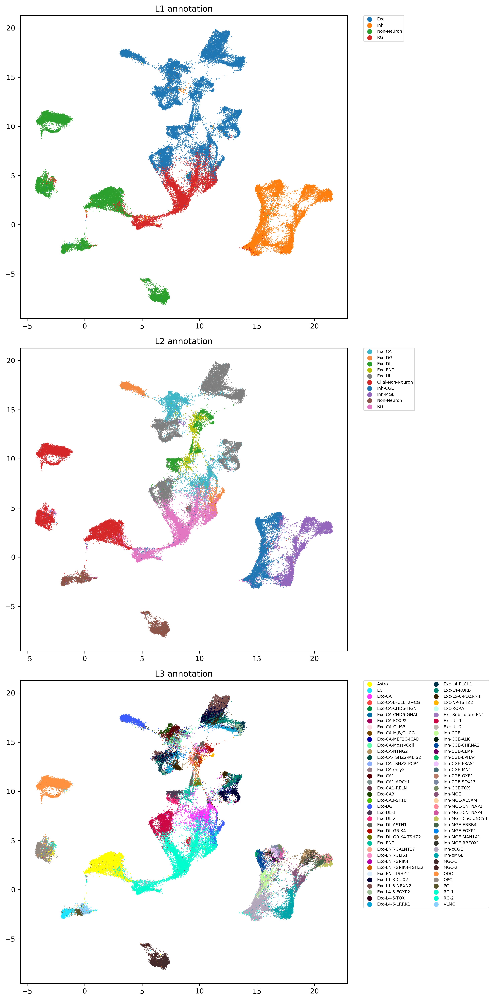

In [10]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300
embed = wrapper.fetch_cell_embedding(final_dim=256,
                                     restore_order=False)
# Check available label information
print (wrapper.label_info.columns)
from umap import UMAP
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import math
embedding = embed['embed_l2_norm']
vec = UMAP(n_components=2, n_neighbors=25, random_state=0, min_dist=0.3).fit_transform(embedding)

# pull the visualization palette from the config file
vis_palette = wrapper.config['vis_palette']


fig = plt.figure(figsize=(10, 20))
for col_index, col in enumerate(["L1 annotation",
                                 "L2 annotation",
                                 "L3 annotation"]):
    ax = plt.subplot(3, 1, col_index + 1)
    sns.scatterplot(x=vec[:, 0], y=vec[:, 1], hue=wrapper.label_info[col], ax=ax, s=2, alpha=0.8, linewidth=0, palette=vis_palette[col])
    handles, labels = ax.get_legend_handles_labels()
    labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
    ax.legend(handles=handles, labels=labels, bbox_to_anchor=(1.05, 1), loc=2, 
              borderaxespad=0., ncol=int(math.ceil(len(labels)) / 40 + 1), prop={'size': 6})
    ax.set_title(col)
plt.tight_layout()
plt.show()
plt.close('all')

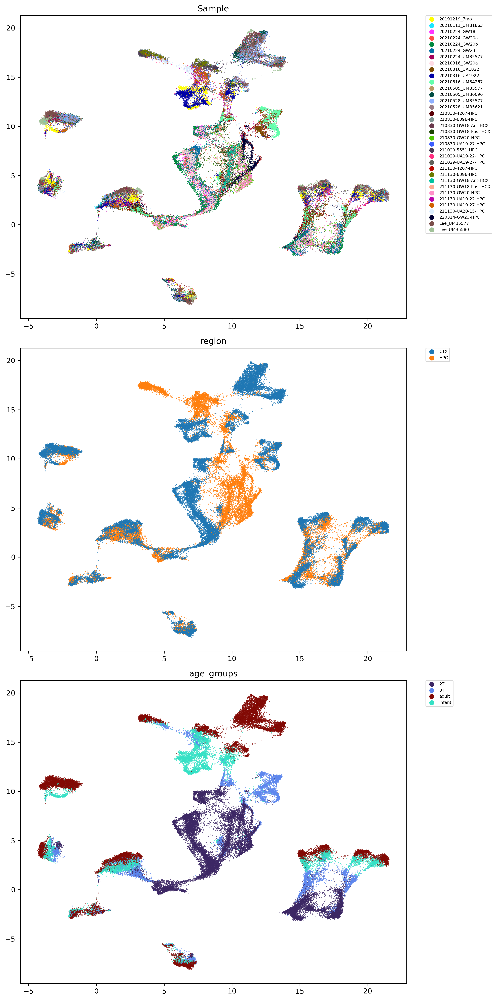

In [11]:
fig = plt.figure(figsize=(10, 20))
for col_index, col in enumerate(["Sample",
                                 "region",
                                 "age_groups"]):
    ax = plt.subplot(3, 1, col_index + 1)
    sns.scatterplot(x=vec[:, 0], y=vec[:, 1], hue=wrapper.label_info[col], ax=ax, s=2, alpha=0.8, linewidth=0, palette=vis_palette[col])
    handles, labels = ax.get_legend_handles_labels()
    labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
    ax.legend(handles=handles, labels=labels, bbox_to_anchor=(1.05, 1), loc=2, 
              borderaxespad=0., ncol=int(math.ceil(len(labels)) / 40 + 1), prop={'size': 6})
    ax.set_title(col)
plt.tight_layout()
plt.show()
plt.close('all')

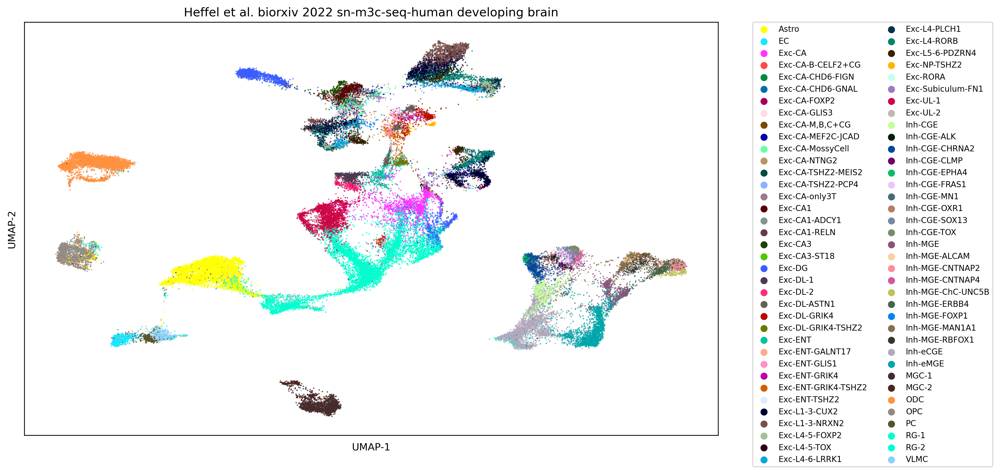

In [12]:
fig = plt.figure(figsize=(14, 7))
col = 'L3 annotation'
ax = sns.scatterplot(x=vec[:, 0], y=vec[:, 1], hue=wrapper.label_info[col], s=2, alpha=0.8, linewidth=0, palette=vis_palette[col])
handles, labels = ax.get_legend_handles_labels()
labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
ax.legend(handles=handles, labels=labels, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., ncol=2, prop={'size':8})
ax.grid(False)
# Hide axes ticks
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('UMAP-1')
ax.set_ylabel('UMAP-2')
ax.set_title( "Heffel et al. biorxiv 2022 sn-m3c-seq-human developing brain")
plt.tight_layout()
plt.show()


In [2]:
from fasthigashi.FastHigashi_Wrapper import *
# Now let's re-run the pipeline at 250kb resolution
config = "/home/rzhang/fast_higashi_git/config_dir/config_m3c_Heffel_DevBrain_250k.JSON"
# initialize the model
wrapper_250 = FastHigashi(config_path=config,
                      path2input_cache=None, # when setting at None, will use the temp_dir on the JSON file
                      path2result_dir=None, # same as above
                      off_diag=100,
                      filter=True,
                      do_conv=False, # True yields similar results
                      do_rwr=True, # True for high-res data
                      do_col=False,
                      no_col=False)
# From contact pairs to the sparse matrices and store them on disk
if not os.path.exists(os.path.join(wrapper_250.temp_dir, "raw", "%s_sparse_adj.npy" % wrapper_250.chrom_list[0])):
    start = time.time()
    wrapper_250.fast_process_data()
    print("contact pairs to sparse mtx takes: %.2f s" % (time.time() - start))
# packing data from sparse matrices to sparse tensors
start = time.time()
wrapper_250.prep_dataset(batch_norm=True) # same as above
print("packing sparse mtx takes: %.2f s" % (time.time() - start))

wrapper_250.run_model(extra="", # can be any words, this will be appended to the model name when the model is saved. Used as an identifier.
                  rank=256,
                  n_iter_parafac=1,
                  tol=2e-5 # In the original manuscript, we use this 3e-4 tolerance, but later we found that setting it to smaller ones might lead to better performance on some data. For this dataset, it leads to more robust results to the initialization
                  )

# loading existing trained models
# This operation is optional when the model is just trained
wrapper_250.load_model(extra="",
                   rank=256,
                   n_iter_parafac=1
                   )

setting to gpu:6
generating start/end dict for chromosome
extracting from filelist.txt


  0%|          | 0/53063 [00:00<?, ?it/s]

fast process finishes
contact pairs to sparse mtx takes: 1007.31 s
total number of cells that pass qc check 51511 bad 1552 total: 53063
cache file = /home/rzhang/Higashi/Temp/m3c_luo_250k/cache_intra_250000_offdiag_100_.pkl
will do per batch normalization


packing sparse mtx into sparse tensors:   0%|          | 0/22 [00:00<?, ?it/s]

Sorting indices in sparse tensors:   0%|          | 0/22 [00:00<?, ?it/s]

saving cached input to /home/rzhang/Higashi/Temp/m3c_luo_250k/cache_intra_250000_offdiag_100_.pkl
gpu mem
c_nvmlMemory_t(total: 25757220864 B, free: 25430523904 B, used: 326696960 B)
sparsity 0.015301372735810616
do_conv False do_rwr True do_col False
recommend_bs_cell [12878, 12878, 12878, 12878, 12878, 12878, 12878, 12878, 12878, 12878, 12878, 12878, 17171, 12878, 12878, 12878, 12878, 17171, 12878, 12878, 25756, 25756] pinning memory
packing sparse mtx takes: 1286.19 s
dim1_0.6_rank_256_niterp_1_
n_iter_parafac 1
time elapsed: 0.02


initializing params:   0%|          | 0/22 [00:00<?, ?it/s]

rwr iters: [7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7]
time elapsed: 281.28
finish init
Starting iteration 0

PARAFAC2 re=3.186 takes 140.9s
Starting iteration 1

PARAFAC2 re=0.650 9.58e-01 variation min7.9e-01 at chrom 20, max9.8e-01 at chrom 1 takes 141.1s
Starting iteration 2

PARAFAC2 re=0.645 1.47e-02 variation min4.6e-03 at chrom 17, max1.5e-02 at chrom 0 takes 140.3s
Starting iteration 3

PARAFAC2 re=0.642 8.40e-03 variation min6.0e-03 at chrom 18, max1.5e-02 at chrom 14 takes 139.9s
Starting iteration 4

PARAFAC2 re=0.641 2.69e-03 variation min1.7e-03 at chrom 1, max1.2e-02 at chrom 21 takes 139.5s
Starting iteration 5

PARAFAC2 re=0.641 1.13e-03 variation min3.8e-04 at chrom 1, max8.0e-03 at chrom 21 takes 139.5s
Starting iteration 6

PARAFAC2 re=0.641 5.80e-04 variation min7.0e-05 at chrom 7, max4.9e-03 at chrom 21 takes 139.7s
Starting iteration 7

PARAFAC2 re=0.641 3.40e-04 variation min-6.4e-06 at chrom 7, max2.7e-03 at chrom 21 takes 140.1s
Starting iteration 8

PARAFAC

Index(['index', 'Cell ID', 'L1 annotation', 'L2 annotation', 'L3 annotation',
       'L4 annotation', 'mCCC/CCC', 'mCH/CH', 'mCG/CG', 'Sample', 'region',
       'age_groups', 'TotalInt', 'cell_name_higashi', 'coverage_fh'],
      dtype='object')


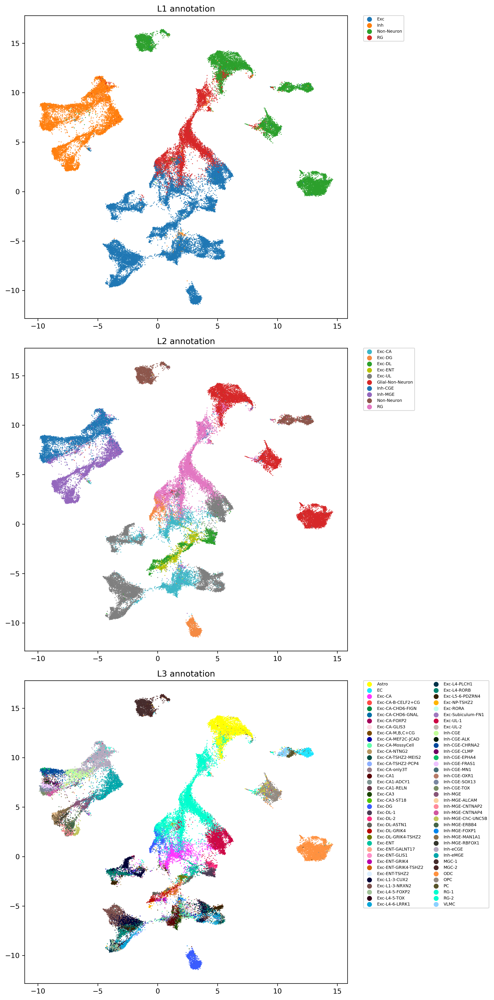

In [6]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300
embed = wrapper_250.fetch_cell_embedding(final_dim=256,
                                     restore_order=False)
# Check available label information
print (wrapper_250.label_info.columns)
from umap import UMAP
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import math
embedding = embed['embed_l2_norm']
vec = UMAP(n_components=2, n_neighbors=25, random_state=0, min_dist=0.3).fit_transform(embedding)

# pull the visualization palette from the config file
vis_palette = wrapper_250.config['vis_palette']


fig = plt.figure(figsize=(10, 20))
for col_index, col in enumerate(["L1 annotation",
                                 "L2 annotation",
                                 "L3 annotation"]):
    ax = plt.subplot(3, 1, col_index + 1)
    sns.scatterplot(x=vec[:, 0], y=vec[:, 1], hue=wrapper_250.label_info[col], ax=ax, s=2, alpha=0.8, linewidth=0, palette=vis_palette[col])
    handles, labels = ax.get_legend_handles_labels()
    labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
    ax.legend(handles=handles, labels=labels, bbox_to_anchor=(1.05, 1), loc=2, 
              borderaxespad=0., ncol=int(math.ceil(len(labels)) / 40 + 1), prop={'size': 6})
    ax.set_title(col)
plt.tight_layout()
plt.show()
plt.close('all')

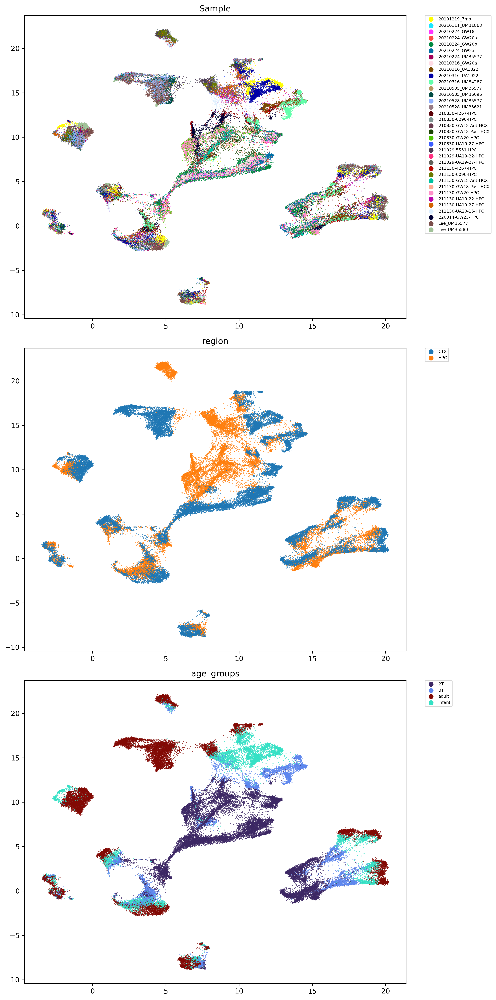

In [4]:
fig = plt.figure(figsize=(10, 20))
for col_index, col in enumerate(["Sample",
                                 "region",
                                 "age_groups"]):
    ax = plt.subplot(3, 1, col_index + 1)
    sns.scatterplot(x=vec[:, 0], y=vec[:, 1], hue=wrapper_250.label_info[col], ax=ax, s=2, alpha=0.8, linewidth=0, palette=vis_palette[col])
    handles, labels = ax.get_legend_handles_labels()
    labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
    ax.legend(handles=handles, labels=labels, bbox_to_anchor=(1.05, 1), loc=2, 
              borderaxespad=0., ncol=int(math.ceil(len(labels)) / 40 + 1), prop={'size': 6})
    ax.set_title(col)
plt.tight_layout()
plt.show()
plt.close('all')

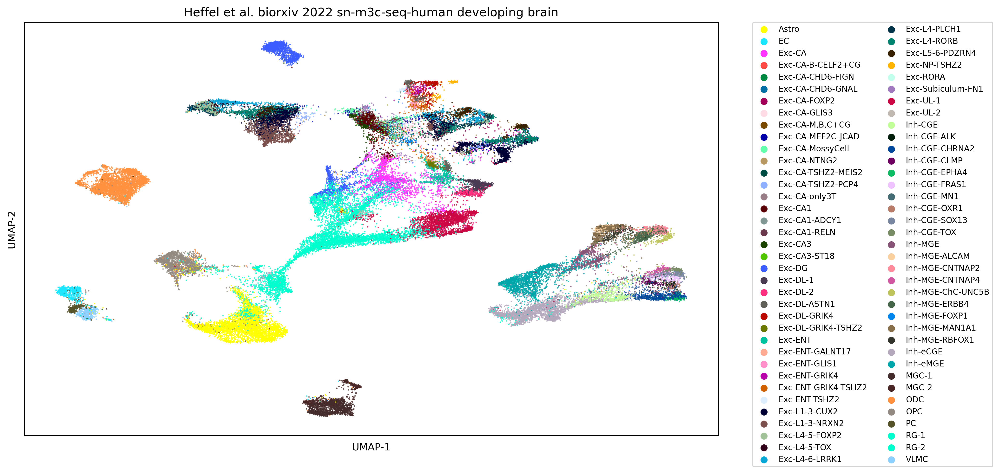

In [5]:
fig = plt.figure(figsize=(14, 7))
col = 'L3 annotation'
ax = sns.scatterplot(x=vec[:, 0], y=vec[:, 1], hue=wrapper_250.label_info[col], s=2, alpha=0.8, linewidth=0, palette=vis_palette[col])
handles, labels = ax.get_legend_handles_labels()
labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
ax.legend(handles=handles, labels=labels, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., ncol=2, prop={'size':8})
ax.grid(False)
# Hide axes ticks
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('UMAP-1')
ax.set_ylabel('UMAP-2')
ax.set_title( "Heffel et al. biorxiv 2022 sn-m3c-seq-human developing brain")
plt.tight_layout()
plt.show()
